# Модель предсказания оттока клиентов телекоммуникационной компании

## Цель проекта

Цель проекта состоит в прогнозировании оттока клиентов оператора связи "Ниединогоразрыва.ком". Необходимо провести исследовательский анализ данных и разработать модель, которая сможет предсказывать, планирует ли клиент уйти.

### План решения задачи

1. Получить и проанализировать данные клиентов телекоммуникационной компании (информация о договорах, персональные данные, информация об услугах интернет и телефонии.

2. Объединить полученные данные, обработать их и подготовить к обучению моделей.

3. Разделить данные на обучающую и тестовую выборку и обучить несколько моделей классификации.

4. Оценить качество и скорость работы моделей.

5. Выбрать лучшую модель, сделать предсказания на тестовой выборке, сделать выводы.

In [1]:
pip install phik

Note: you may need to restart the kernel to use updated packages.


In [2]:
# импорт библиотек
from functools import reduce
import time

import pandas as pd
import matplotlib.pyplot as plt
import phik
import lightgbm as lgb
import numpy as np

from phik.report import plot_correlation_matrix
from phik import report
from sklearn.model_selection import (
    train_test_split,
    GridSearchCV,
    cross_val_score
)
from sklearn.metrics import (
    roc_auc_score,
    RocCurveDisplay,
    ConfusionMatrixDisplay
)
from sklearn.preprocessing import (
    OneHotEncoder,
    StandardScaler
)
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.pipeline import Pipeline
from sklearn.compose import make_column_transformer
from sklearn.compose import ColumnTransformer

# обозначим константы
RANDOM_STATE = 11092023

In [3]:
try:
    df_contract = pd.read_csv('https://code.s3.yandex.net/datasets/contract_new.csv')
    df_internet = pd.read_csv('https://code.s3.yandex.net/datasets/internet_new.csv')
    df_personal = pd.read_csv('https://code.s3.yandex.net/datasets/personal_new.csv')
    df_phone = pd.read_csv('https://code.s3.yandex.net/datasets/phone_new.csv')
except FileNotFoundError:
    # Обработка ошибки, если файлы не найдены
    print("Один или несколько файлов не найдены.")

### Анализ данных

In [4]:
df_contract.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7043 entries, 0 to 7042
Data columns (total 8 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   customerID        7043 non-null   object 
 1   BeginDate         7043 non-null   object 
 2   EndDate           7043 non-null   object 
 3   Type              7043 non-null   object 
 4   PaperlessBilling  7043 non-null   object 
 5   PaymentMethod     7043 non-null   object 
 6   MonthlyCharges    7043 non-null   float64
 7   TotalCharges      7043 non-null   object 
dtypes: float64(1), object(7)
memory usage: 440.3+ KB


In [5]:
df_contract.head()

,customerID,BeginDate,EndDate,Type,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges
0,7590-VHVEG,2020-01-01,No,Month-to-month,Yes,Electronic check,29.85,31.04
1,5575-GNVDE,2017-04-01,No,One year,No,Mailed check,56.95,2071.84
2,3668-QPYBK,2019-10-01,No,Month-to-month,Yes,Mailed check,53.85,226.17
3,7795-CFOCW,2016-05-01,No,One year,No,Bank transfer (automatic),42.30,1960.6
4,9237-HQITU,2019-09-01,No,Month-to-month,Yes,Electronic check,70.70,353.5


In [6]:
df_contract.tail()

,customerID,BeginDate,EndDate,Type,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges
7038,6840-RESVB,2018-02-01,No,One year,Yes,Mailed check,84.80,2035.2
7039,2234-XADUH,2014-02-01,No,One year,Yes,Credit card (automatic),103.20,7430.4
7040,4801-JZAZL,2019-03-01,No,Month-to-month,Yes,Electronic check,29.60,325.6
7041,8361-LTMKD,2019-07-01,No,Month-to-month,Yes,Mailed check,74.40,520.8
7042,3186-AJIEK,2014-08-01,No,Two year,Yes,Bank transfer (automatic),105.65,7251.82


Посмотрим на значения в столбце EndDate:

In [7]:
df_contract['EndDate'].value_counts().head()

No            5942
2020-01-01      39
2019-12-01      38
2018-11-01      35
2019-09-01      32
Name: EndDate, dtype: int64

Объединим файлы по столбцу customerID, убедимся, что в нем нет повторов:

In [8]:
print('Количество повторяющихся значений в столбце customerID:', 
      df_contract['customerID'].duplicated().sum())

Количество повторяющихся значений в столбце customerID: 0


Пропуски отсутствуют; в столбцах BeginDate и EndDate тип данных нужно заменить на datetime; повторы в customerID отсутствуют.

In [9]:
df_internet.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5517 entries, 0 to 5516
Data columns (total 8 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   customerID        5517 non-null   object
 1   InternetService   5517 non-null   object
 2   OnlineSecurity    5517 non-null   object
 3   OnlineBackup      5517 non-null   object
 4   DeviceProtection  5517 non-null   object
 5   TechSupport       5517 non-null   object
 6   StreamingTV       5517 non-null   object
 7   StreamingMovies   5517 non-null   object
dtypes: object(8)
memory usage: 344.9+ KB


In [10]:
df_internet.head()

,customerID,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies
0,7590-VHVEG,DSL,No,Yes,No,No,No,No
1,5575-GNVDE,DSL,Yes,No,Yes,No,No,No
2,3668-QPYBK,DSL,Yes,Yes,No,No,No,No
3,7795-CFOCW,DSL,Yes,No,Yes,Yes,No,No
4,9237-HQITU,Fiber optic,No,No,No,No,No,No


In [11]:
df_internet.tail()

,customerID,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies
5512,6840-RESVB,DSL,Yes,No,Yes,Yes,Yes,Yes
5513,2234-XADUH,Fiber optic,No,Yes,Yes,No,Yes,Yes
5514,4801-JZAZL,DSL,Yes,No,No,No,No,No
5515,8361-LTMKD,Fiber optic,No,No,No,No,No,No
5516,3186-AJIEK,Fiber optic,Yes,No,Yes,Yes,Yes,Yes


Количество строк меньше, чем в предыдущих файлах.

Поверим столбец customerID на уникальность:

In [12]:
print('Уникальные значения столбца customerID:', 
      df_internet['customerID'].nunique())

Уникальные значения столбца customerID: 5517


Делаю выводы что не все клиенты пользуються интернетом

In [13]:
df_personal.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7043 entries, 0 to 7042
Data columns (total 5 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   customerID     7043 non-null   object
 1   gender         7043 non-null   object
 2   SeniorCitizen  7043 non-null   int64 
 3   Partner        7043 non-null   object
 4   Dependents     7043 non-null   object
dtypes: int64(1), object(4)
memory usage: 275.2+ KB


In [14]:
df_personal.head()

,customerID,gender,SeniorCitizen,Partner,Dependents
0,7590-VHVEG,Female,0,Yes,No
1,5575-GNVDE,Male,0,No,No
2,3668-QPYBK,Male,0,No,No
3,7795-CFOCW,Male,0,No,No
4,9237-HQITU,Female,0,No,No


In [15]:
df_personal.tail()

,customerID,gender,SeniorCitizen,Partner,Dependents
7038,6840-RESVB,Male,0,Yes,Yes
7039,2234-XADUH,Female,0,Yes,Yes
7040,4801-JZAZL,Female,0,Yes,Yes
7041,8361-LTMKD,Male,1,Yes,No
7042,3186-AJIEK,Male,0,No,No


Также посмотрим на количество повторов в столбце customerID:

In [16]:
print('Количество повторяющихся значений в столбце customerID:', 
      df_personal['customerID'].duplicated().sum())

Количество повторяющихся значений в столбце customerID: 0


Пропуски отсутствуют; количество столбцов совпадает с количеством в файле contract; повторы в customerID отсутствуют.

In [17]:
df_phone.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6361 entries, 0 to 6360
Data columns (total 2 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   customerID     6361 non-null   object
 1   MultipleLines  6361 non-null   object
dtypes: object(2)
memory usage: 99.5+ KB


In [18]:
df_phone.head()

,customerID,MultipleLines
0,5575-GNVDE,No
1,3668-QPYBK,No
2,9237-HQITU,No
3,9305-CDSKC,Yes
4,1452-KIOVK,Yes


Проверим количество уникальных значений в столбце customerID:

In [19]:
print('Уникальные значения столбца customerID:', 
      df_phone['customerID'].nunique())

Уникальные значения столбца customerID: 6361


Количество пользователей в данном файле также меньше, чем в contract_new и personal_new, делаю вывод, что не все пользователи используют услуги телефонии.

### Объединение 4  таблиц в одну 

Объединим все файлы по столбцу customerID. Т. к. нам необходимо сохранить всех пользователей из файлов contract_new и personal_new, используем тип объединения outer.

In [20]:
df = reduce(lambda left, right: pd.merge(left, right, on=['customerID'],
                                         how='outer'), [df_contract, df_internet, df_personal, df_phone])

In [21]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7043 entries, 0 to 7042
Data columns (total 20 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   customerID        7043 non-null   object 
 1   BeginDate         7043 non-null   object 
 2   EndDate           7043 non-null   object 
 3   Type              7043 non-null   object 
 4   PaperlessBilling  7043 non-null   object 
 5   PaymentMethod     7043 non-null   object 
 6   MonthlyCharges    7043 non-null   float64
 7   TotalCharges      7043 non-null   object 
 8   InternetService   5517 non-null   object 
 9   OnlineSecurity    5517 non-null   object 
 10  OnlineBackup      5517 non-null   object 
 11  DeviceProtection  5517 non-null   object 
 12  TechSupport       5517 non-null   object 
 13  StreamingTV       5517 non-null   object 
 14  StreamingMovies   5517 non-null   object 
 15  gender            7043 non-null   object 
 16  SeniorCitizen     7043 non-null   int64  


In [22]:
df.head()

,customerID,BeginDate,EndDate,Type,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,gender,SeniorCitizen,Partner,Dependents,MultipleLines
0,7590-VHVEG,2020-01-01,No,Month-to-month,Yes,Electronic check,29.85,31.04,DSL,No,Yes,No,No,No,No,Female,0,Yes,No,NaN
1,5575-GNVDE,2017-04-01,No,One year,No,Mailed check,56.95,2071.84,DSL,Yes,No,Yes,No,No,No,Male,0,No,No,No
2,3668-QPYBK,2019-10-01,No,Month-to-month,Yes,Mailed check,53.85,226.17,DSL,Yes,Yes,No,No,No,No,Male,0,No,No,No
3,7795-CFOCW,2016-05-01,No,One year,No,Bank transfer (automatic),42.30,1960.6,DSL,Yes,No,Yes,Yes,No,No,Male,0,No,No,NaN
4,9237-HQITU,2019-09-01,No,Month-to-month,Yes,Electronic check,70.70,353.5,Fiber optic,No,No,No,No,No,No,Female,0,No,No,No


Объединение успешно, количество пользователей совпадает с количеством в файле contract_new.

В результате объединения в столбцах, связанных с услугами интернета и телефонии, появились пропуски. Заполним их на этапе подготовки данных к обучению модели.

**Анализ общего датафрейма**

Проверим минимальное и максимальное значения в столбцах BeginDate и EndDate.

In [23]:
print('Диапазон данных в столбце BeginDate:', 
      df['BeginDate'].min(), 
      '-', 
      df['BeginDate'].max())

Диапазон данных в столбце BeginDate: 2013-10-01 - 2020-02-01


Диапазон начала действия договора не вызывает вопросов, т. к. по условиям данные актуальны на 1 февраля 2020 года.

In [24]:
print('Диапазон данных в столбце EndDate:', 
      df['EndDate'].min(), 
      '-', 
      df['EndDate'].value_counts().sort_values().index[-2]) # исключаем значение 'No', которое берется как максимальное

Диапазон данных в столбце EndDate: 2014-06-01 - 2020-01-01


В этом столбце также нет значений, превышающих дату выгрузки данных.

На основе данного столбца мы создадим целевой признак, где значения No будут означать, что клиент продолжает сотрудничество с компанией, а значение даты говорит о том, что клиент уже ушел.

**Предварительный вывод по EDA**

1. Есть клиенты которые не пользуются интернетом или телефонией
2. Действительно все данные до 1 февраля 2020 года
3. Некоторым столбцам нужно поменять тип данных

Вопросы отсутствуют.

**План решения задачи после EDA**

1. Обработать сводный датасет и подготовить его к обучению модели.

2. Выбрать столбцы (параметры), актуальные для обучения модели, при необходимости создать новые.

3. Разделить данные на обучающую и тестовую выборки.

4. Обучить несколько моделей классификации и сравнить их показатели на кросс-валидации по обучающей выборке.

5. Выбрать лучшую модель, проверить ее качество на тестовой выборке и представить результаты.

**Цель проекта**

Обучить модель предсказывать отток клиентов со значением метрики ROC-AUC не ниже 0.85.

**Предобработка данных**

Выведем еще раз информацию по сводному датафрейму:

In [25]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7043 entries, 0 to 7042
Data columns (total 20 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   customerID        7043 non-null   object 
 1   BeginDate         7043 non-null   object 
 2   EndDate           7043 non-null   object 
 3   Type              7043 non-null   object 
 4   PaperlessBilling  7043 non-null   object 
 5   PaymentMethod     7043 non-null   object 
 6   MonthlyCharges    7043 non-null   float64
 7   TotalCharges      7043 non-null   object 
 8   InternetService   5517 non-null   object 
 9   OnlineSecurity    5517 non-null   object 
 10  OnlineBackup      5517 non-null   object 
 11  DeviceProtection  5517 non-null   object 
 12  TechSupport       5517 non-null   object 
 13  StreamingTV       5517 non-null   object 
 14  StreamingMovies   5517 non-null   object 
 15  gender            7043 non-null   object 
 16  SeniorCitizen     7043 non-null   int64  


In [26]:
df.head()

,customerID,BeginDate,EndDate,Type,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,gender,SeniorCitizen,Partner,Dependents,MultipleLines
0,7590-VHVEG,2020-01-01,No,Month-to-month,Yes,Electronic check,29.85,31.04,DSL,No,Yes,No,No,No,No,Female,0,Yes,No,NaN
1,5575-GNVDE,2017-04-01,No,One year,No,Mailed check,56.95,2071.84,DSL,Yes,No,Yes,No,No,No,Male,0,No,No,No
2,3668-QPYBK,2019-10-01,No,Month-to-month,Yes,Mailed check,53.85,226.17,DSL,Yes,Yes,No,No,No,No,Male,0,No,No,No
3,7795-CFOCW,2016-05-01,No,One year,No,Bank transfer (automatic),42.30,1960.6,DSL,Yes,No,Yes,Yes,No,No,Male,0,No,No,NaN
4,9237-HQITU,2019-09-01,No,Month-to-month,Yes,Electronic check,70.70,353.5,Fiber optic,No,No,No,No,No,No,Female,0,No,No,No


В рамках предобработки нужно выполнить следующие шаги:

1. Заполнить пропуски в данных.

2. Выделить целевой признак и проверить его на дисбаланс классов.

3. Создать при необходимости новые признаки.

4. Проверить признаки на мультиколлинеарность.

5. Выбрать необходимые для обучения модели признаки.

**Заполнение пропусков и изменение формата данных**

Выведем информацию о явных пропусках:

In [27]:
print('Явные пропуски до обработки')
df.isna().sum()

Явные пропуски до обработки


customerID             0
BeginDate              0
EndDate                0
Type                   0
PaperlessBilling       0
PaymentMethod          0
MonthlyCharges         0
TotalCharges           0
InternetService     1526
OnlineSecurity      1526
OnlineBackup        1526
DeviceProtection    1526
TechSupport         1526
StreamingTV         1526
StreamingMovies     1526
gender                 0
SeniorCitizen          0
Partner                0
Dependents             0
MultipleLines        682
dtype: int64

Так как выявленные пропуски связаны с тем, что не все клиенты пользуются услугами интернета и телефонии, заполним их отдельным значением not_used.

In [28]:
df = df.fillna('not_used')

In [29]:
# проверка заполнения пропусков
print('Явные пропуски после обработки')
df.isna().sum()

Явные пропуски после обработки


customerID          0
BeginDate           0
EndDate             0
Type                0
PaperlessBilling    0
PaymentMethod       0
MonthlyCharges      0
TotalCharges        0
InternetService     0
OnlineSecurity      0
OnlineBackup        0
DeviceProtection    0
TechSupport         0
StreamingTV         0
StreamingMovies     0
gender              0
SeniorCitizen       0
Partner             0
Dependents          0
MultipleLines       0
dtype: int64

Теперь посмотрим на значения в каждом из столбцов датафрейма с помощью метода value_counts:

In [30]:
for column in df.columns:
    print(column)
    print(df[column].value_counts().sort_values(ascending=False))
    print()

customerID
7590-VHVEG    1
0280-XJGEX    1
7795-CFOCW    1
9237-HQITU    1
9305-CDSKC    1
             ..
2234-XADUH    1
4801-JZAZL    1
8361-LTMKD    1
1122-JWTJW    1
3186-AJIEK    1
Name: customerID, Length: 7043, dtype: int64

BeginDate
2014-02-01    366
2019-09-01    237
2019-10-01    237
2019-11-01    237
2020-01-01    233
             ... 
2020-02-01     11
2014-01-01      7
2013-10-01      3
2013-12-01      3
2013-11-01      2
Name: BeginDate, Length: 77, dtype: int64

EndDate
No            5942
2020-01-01      39
2019-12-01      38
2018-11-01      35
2019-09-01      32
              ... 
2014-09-01       2
2014-12-01       2
2014-06-01       1
2014-10-01       1
2014-11-01       1
Name: EndDate, Length: 67, dtype: int64

Type
Month-to-month    3875
Two year          1695
One year          1473
Name: Type, dtype: int64

PaperlessBilling
Yes    4171
No     2872
Name: PaperlessBilling, dtype: int64

PaymentMethod
Electronic check             2365
Mailed check                 16

Мы видим потенциальные пропуски в столбце TotalCharges.



In [31]:
# Преобразуем TotalCharges во float, в процессе обнаружилась ошибка, посмотрим на данные
df['TotalCharges'] = pd.to_numeric(df['TotalCharges'], errors='coerce')
# Посмотрим, что вызывало ошибку
df[df['TotalCharges'].isnull()]

,customerID,BeginDate,EndDate,Type,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,gender,SeniorCitizen,Partner,Dependents,MultipleLines
488,4472-LVYGI,2020-02-01,No,Two year,Yes,Bank transfer (automatic),52.55,NaN,DSL,Yes,No,Yes,Yes,Yes,No,Female,0,Yes,Yes,not_used
753,3115-CZMZD,2020-02-01,No,Two year,No,Mailed check,20.25,NaN,not_used,not_used,not_used,not_used,not_used,not_used,not_used,Male,0,No,Yes,No
936,5709-LVOEQ,2020-02-01,No,Two year,No,Mailed check,80.85,NaN,DSL,Yes,Yes,Yes,No,Yes,Yes,Female,0,Yes,Yes,No
1082,4367-NUYAO,2020-02-01,No,Two year,No,Mailed check,25.75,NaN,not_used,not_used,not_used,not_used,not_used,not_used,not_used,Male,0,Yes,Yes,Yes
1340,1371-DWPAZ,2020-02-01,No,Two year,No,Credit card (automatic),56.05,NaN,DSL,Yes,Yes,Yes,Yes,Yes,No,Female,0,Yes,Yes,not_used
3331,7644-OMVMY,2020-02-01,No,Two year,No,Mailed check,19.85,NaN,not_used,not_used,not_used,not_used,not_used,not_used,not_used,Male,0,Yes,Yes,No
3826,3213-VVOLG,2020-02-01,No,Two year,No,Mailed check,25.35,NaN,not_used,not_used,not_used,not_used,not_used,not_used,not_used,Male,0,Yes,Yes,Yes
4380,2520-SGTTA,2020-02-01,No,Two year,No,Mailed check,20.00,NaN,not_used,not_used,not_used,not_used,not_used,not_used,not_used,Female,0,Yes,Yes,No
5218,2923-ARZLG,2020-02-01,No,One year,Yes,Mailed check,19.70,NaN,not_used,not_used,not_used,not_used,not_used,not_used,not_used,Male,0,Yes,Yes,No
6670,4075-WKNIU,2020-02-01,No,Two year,No,Mailed check,73.35,NaN,DSL,No,Yes,Yes,Yes,Yes,No,Female,0,Yes,Yes,Yes


Заменим пропущеные строки с пропущенными значениями  на 0(так как очевидно, что это клиенты, которые пользуются услугами меньше месяца и еще не успели ничего заплатить, поэтому присвоим им нулевые общие отчисления.).


In [32]:
df['TotalCharges'] = df['TotalCharges'].fillna(0)

Проверим сохранились ли данные правильно

In [33]:
df[df['BeginDate'] == '2020-02-01']

,customerID,BeginDate,EndDate,Type,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,gender,SeniorCitizen,Partner,Dependents,MultipleLines
488,4472-LVYGI,2020-02-01,No,Two year,Yes,Bank transfer (automatic),52.55,0.0,DSL,Yes,No,Yes,Yes,Yes,No,Female,0,Yes,Yes,not_used
753,3115-CZMZD,2020-02-01,No,Two year,No,Mailed check,20.25,0.0,not_used,not_used,not_used,not_used,not_used,not_used,not_used,Male,0,No,Yes,No
936,5709-LVOEQ,2020-02-01,No,Two year,No,Mailed check,80.85,0.0,DSL,Yes,Yes,Yes,No,Yes,Yes,Female,0,Yes,Yes,No
1082,4367-NUYAO,2020-02-01,No,Two year,No,Mailed check,25.75,0.0,not_used,not_used,not_used,not_used,not_used,not_used,not_used,Male,0,Yes,Yes,Yes
1340,1371-DWPAZ,2020-02-01,No,Two year,No,Credit card (automatic),56.05,0.0,DSL,Yes,Yes,Yes,Yes,Yes,No,Female,0,Yes,Yes,not_used
3331,7644-OMVMY,2020-02-01,No,Two year,No,Mailed check,19.85,0.0,not_used,not_used,not_used,not_used,not_used,not_used,not_used,Male,0,Yes,Yes,No
3826,3213-VVOLG,2020-02-01,No,Two year,No,Mailed check,25.35,0.0,not_used,not_used,not_used,not_used,not_used,not_used,not_used,Male,0,Yes,Yes,Yes
4380,2520-SGTTA,2020-02-01,No,Two year,No,Mailed check,20.00,0.0,not_used,not_used,not_used,not_used,not_used,not_used,not_used,Female,0,Yes,Yes,No
5218,2923-ARZLG,2020-02-01,No,One year,Yes,Mailed check,19.70,0.0,not_used,not_used,not_used,not_used,not_used,not_used,not_used,Male,0,Yes,Yes,No
6670,4075-WKNIU,2020-02-01,No,Two year,No,Mailed check,73.35,0.0,DSL,No,Yes,Yes,Yes,Yes,No,Female,0,Yes,Yes,Yes


Посмотрим на распределение значений в столбцах TotalCharges и MonthlyCharges:

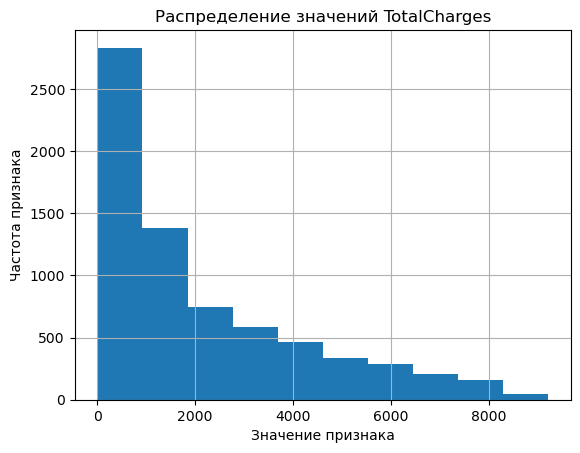

In [34]:
df['TotalCharges'].hist(bins=10)
plt.title('Распределение значений TotalCharges')
plt.xlabel('Значение признака')
plt.ylabel('Частота признака')
plt.show()

Мы видим, что распределение выглядит правдоподобно с пиком возле низких значений и постепенно снижающейся частотой по мере увеличения общей суммы выплат.

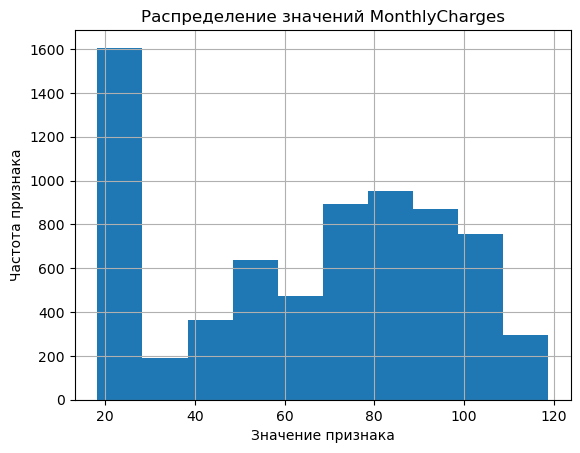

In [35]:
df['MonthlyCharges'].hist(bins=10)
plt.title('Распределение значений MonthlyCharges')
plt.xlabel('Значение признака')
plt.ylabel('Частота признака')
plt.show()

Распределение значений неоднородно с пиками возле определенных значений и небольшими отклонениями от них. Можно предположить, что пики представляют собой стандартные наборы услуг в рамках определенного тарифа, а окружающие их значения - доплату или скидку за их изменение либо в силу прочих факторов.

Также присутствует основной пик возле значения 20. Посмотрим на него подробнее:

In [36]:
print('Распределение клиентов по использованию интернета, ежемесячный платеж которых составляет менее 25 долларов')
df[df['MonthlyCharges'] < 25]['InternetService'].value_counts()

Распределение клиентов по использованию интернета, ежемесячный платеж которых составляет менее 25 долларов


not_used    1350
DSL           39
Name: InternetService, dtype: int64

Мы видим, что пик возле размера платежа в 20 долларов обусловлен тем, что данные клиенты не используют услуги интернета.

Также посмотрим, сколько платят пользователи, которые не пользуются ни интернетом, ни телефоном:

In [37]:
df[(df['InternetService'] == 'not_used') & (df['MultipleLines'] == 'not_used')]

,customerID,BeginDate,EndDate,Type,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,gender,SeniorCitizen,Partner,Dependents,MultipleLines


Такие клиенты отсутствуют. Проверим, посмотрев на распределение параметра MultipleLines у клиентов, не использующих интернет:

In [38]:
df[(df['InternetService'] == 'not_used')]['MultipleLines'].value_counts()

No     1184
Yes     342
Name: MultipleLines, dtype: int64

Значение No означает, что данные пользователи не используют несколько линий, однако телефон у всех таких клиентов есть.

**Выделение целевого признака**

Создадим целевой признак на основе столбца EndDate. Ушедший клиент будет обозначен на основе значения No (что означает отсутствие даты завершения контракта), а значение даты будет означать, что договор с клиентом действителен.

In [39]:
df.loc[df['EndDate'] == 'No', 'Churn'] = 0
df.loc[df['EndDate'] != 'No', 'Churn'] = 1
df['Churn'] = df['Churn'].astype('int')

Посмотрим на распределение целевого признака:

In [40]:
df['Churn'].value_counts()

0    5942
1    1101
Name: Churn, dtype: int64

Сравним с количеством No в столбце EndDate:

In [41]:
(df['EndDate'] == 'No').sum()

5942

Количество совпадает, целевой столбец создан верно.

В то же время мы видим дисбаланс классов - число уже ушедших клиентов существенно больше. Однако, в связи с тем что в качестве целевой метрики мы используем ROC-AUC, которая не подвержена влиянию дисбаланса классов, корректировать дисбаланс необходимости нет.

**Создание новых признаков**

Также создадим новый признак на основе столбцов BeginDate и EndDate, обозначающий количество дней, которое пользователь был (либо является) клиентом компании.

In [42]:
# заполним значения 'No' датой выгрузки датасета
df.loc[df['EndDate'] == 'No', 'EndDate'] ='2020-02-01'

Далее скорректируем формат данных у столбцов:

In [43]:
df['BeginDate'] = pd.to_datetime(df['BeginDate'], format='%Y-%m-%d')
df['EndDate'] = pd.to_datetime(df['EndDate'], format='%Y-%m-%d')

Создадим столбец ContractTerm:

In [44]:
df['ContractTerm'] = df['EndDate'] - df['BeginDate']
df['ContractTerm'] = df['ContractTerm'].dt.days # конвертируем количество дней в формат int

Посмотрим на распределение:

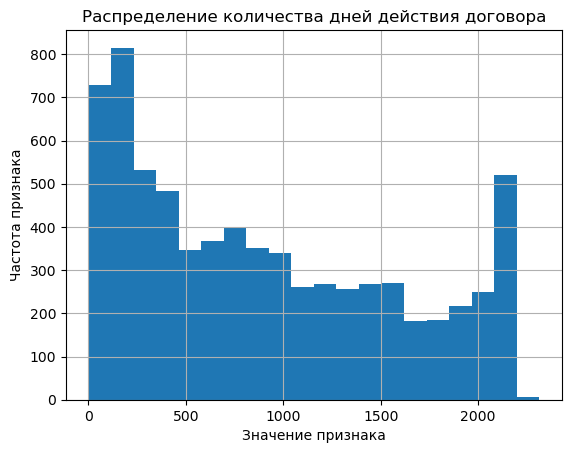

In [45]:
df['ContractTerm'].hist(bins=20)
plt.title('Распределение количества дней действия договора')
plt.xlabel('Значение признака')
plt.ylabel('Частота признака')
plt.show()

На графике виден пик после 2000 дней действия договора. Посмотрим на параметр TotalCharges у таких клиентов, чтобы оценить достоверность значений:

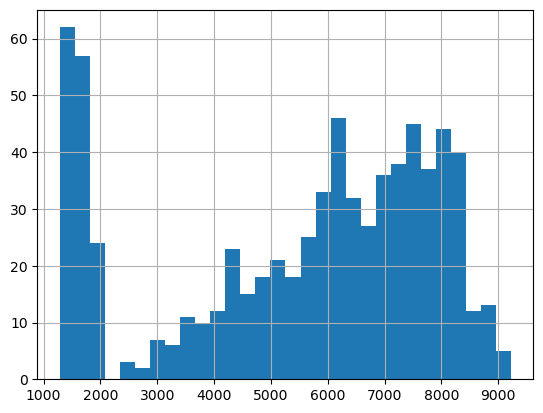

In [46]:
df[df['ContractTerm']>2000]['TotalCharges'].hist(bins=30)
plt.show()

Видим, что у многих клиентов из этой категории общая уплаченная сумма меньше 2000 долларов. Рассмотрим таких клиентов подробнее. Посчитаем среднюю ежемесячную плату по данным клиентам.

In [47]:
df[(df['ContractTerm'] > 2000) & (df['TotalCharges'] < 2000)]['MonthlyCharges'].mean()

22.743706293706285

In [48]:
print('Расчетная сумма за 2000 дней:', 22.74 / 30 * 2000)

Расчетная сумма за 2000 дней: 1515.9999999999998


Видим, что сумма выглядит правдоподобно. Она может связана с тем, что данные клиенты пользуются самым дешевым тарифом.

**Анализ признаков**

Также исследуем признаки в разрезе ушедших/оставшихся клиентов:

In [49]:
# напишем функцию для анализа качественных признаков
def left_actual_df_cat(df, column):
    left = df[df['Churn'] == 1][column].value_counts().values
    actual = df[df['Churn'] == 0][column].value_counts().values
    df = pd.DataFrame(index=df[column].unique(), data={'Ушедший клиент': left, 
                                                      '% от ушедших': np.round(left / left.sum() * 100, 2),
                                                      'Действующий клиент': actual, 
                                                      '% от действующих': np.round(actual / actual.sum() * 100, 2)})
    df.index.name = column
    
   
    fig, ax = plt.subplots()
    df[['Ушедший клиент', 'Действующий клиент']].plot(kind='bar', ax=ax)
    ax.set_ylabel('Количество клиентов')
    ax.set_xlabel(column)
    ax.set_title('Анализ качественного признака: {}'.format(column))
    plt.show()
    
    return df

Type

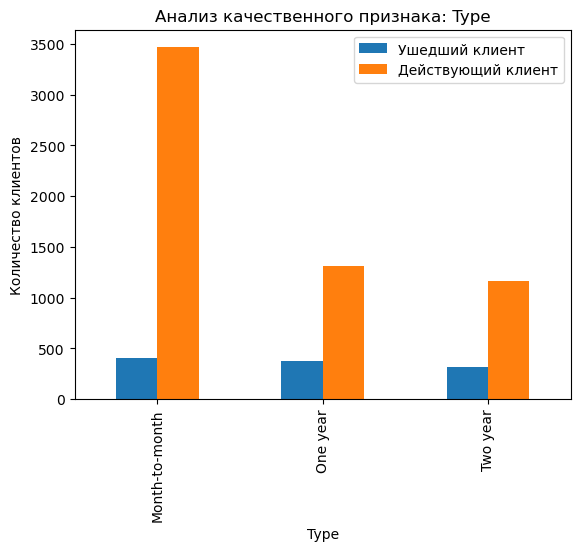

,Ушедший клиент,% от ушедших,Действующий клиент,% от действующих
Type,,,,
Month-to-month,407,36.97,3468,58.36
One year,381,34.60,1314,22.11
Two year,313,28.43,1160,19.52


In [50]:
left_actual_df_cat(df, 'Type')

Видим, что % ушедших клиентов распределен равномерно!   

PaperlessBilling

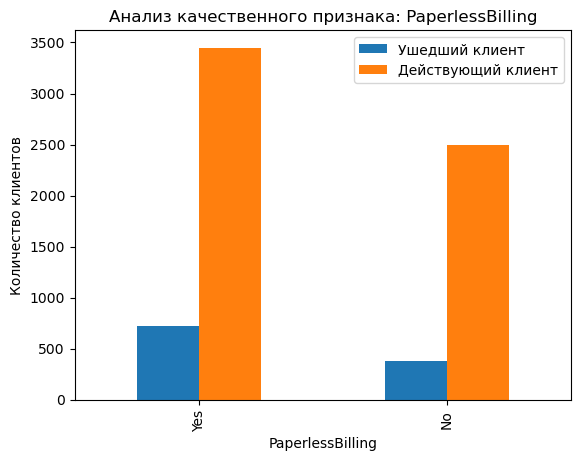

,Ушедший клиент,% от ушедших,Действующий клиент,% от действующих
PaperlessBilling,,,,
Yes,721,65.49,3450,58.06
No,380,34.51,2492,41.94


In [51]:
left_actual_df_cat(df, 'PaperlessBilling')

Соотношение типа платежного документа примерно одинаковое: электронных больше в обеих группах.

PaymentMethod

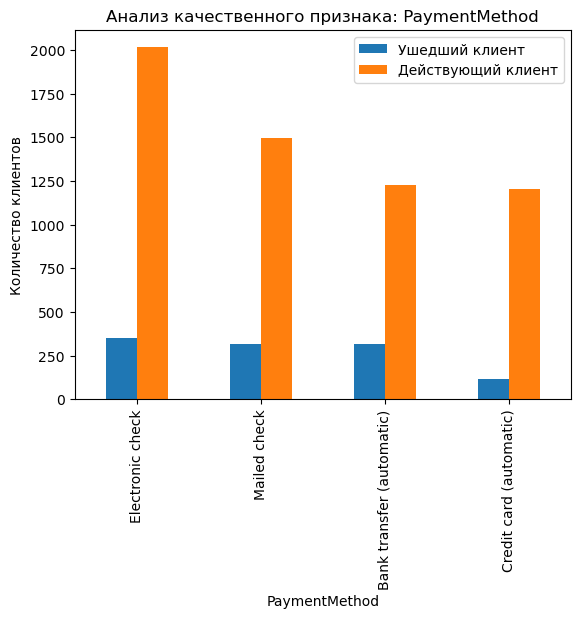

,Ушедший клиент,% от ушедших,Действующий клиент,% от действующих
PaymentMethod,,,,
Electronic check,350,31.79,2015,33.91
Mailed check,317,28.79,1495,25.16
Bank transfer (automatic),317,28.79,1227,20.65
Credit card (automatic),117,10.63,1205,20.28


In [52]:
left_actual_df_cat(df, 'PaymentMethod')

Способ оплаты в двух группах различается незначительно: у действующих клиентов меньшая доля автоматической оплаты с карты.

gender

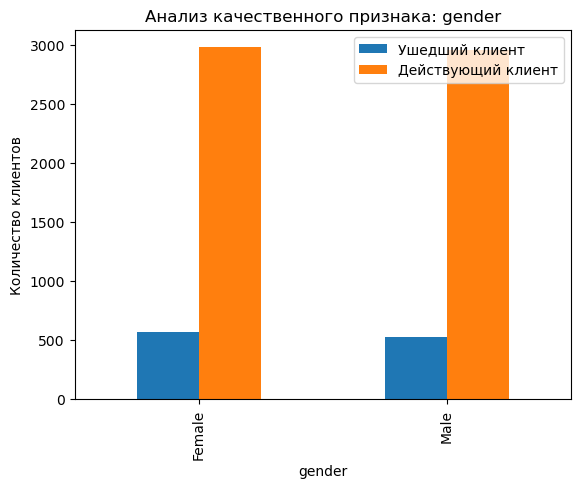

,Ушедший клиент,% от ушедших,Действующий клиент,% от действующих
gender,,,,
Female,573,52.04,2982,50.19
Male,528,47.96,2960,49.81


In [53]:
left_actual_df_cat(df, 'gender')

Различий по полу практически нет.

SeniorCitizen

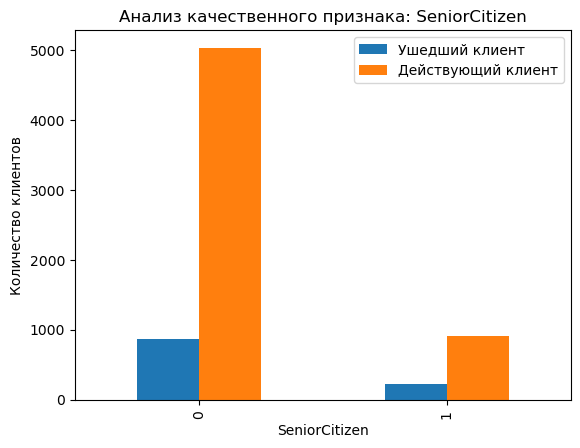

,Ушедший клиент,% от ушедших,Действующий клиент,% от действующих
SeniorCitizen,,,,
0,869,78.93,5032,84.69
1,232,21.07,910,15.31


In [54]:
left_actual_df_cat(df, 'SeniorCitizen')

Доля пенсионеров почти также сопоставима.

Partner

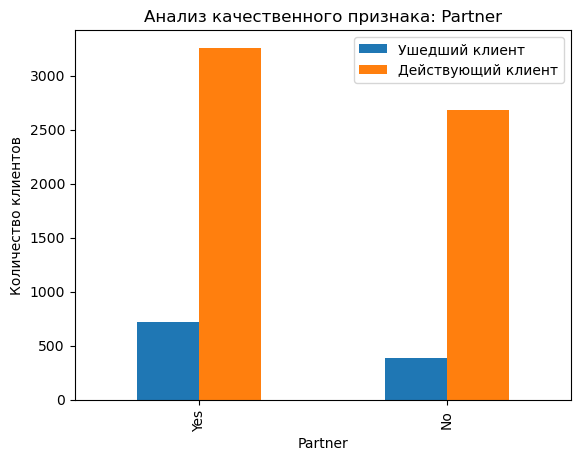

,Ушедший клиент,% от ушедших,Действующий клиент,% от действующих
Partner,,,,
Yes,719,65.3,3259,54.85
No,382,34.7,2683,45.15


In [55]:
left_actual_df_cat(df, 'Partner')

Доля замужних(женатых) клиентов выше в обеих случаях.

Dependents

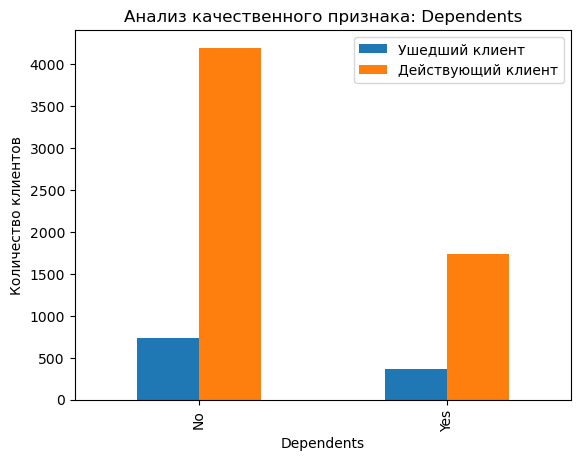

,Ушедший клиент,% от ушедших,Действующий клиент,% от действующих
Dependents,,,,
No,733,66.58,4200,70.68
Yes,368,33.42,1742,29.32


In [56]:
left_actual_df_cat(df, 'Dependents')

Доля клиентов, имеющих иждивенцев, меньше.

InternetService

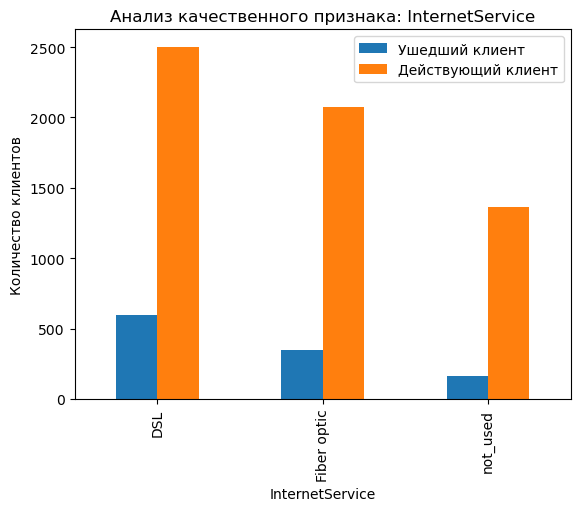

,Ушедший клиент,% от ушедших,Действующий клиент,% от действующих
InternetService,,,,
DSL,595,54.04,2501,42.09
Fiber optic,346,31.43,2075,34.92
not_used,160,14.53,1366,22.99


In [57]:
left_actual_df_cat(df, 'InternetService')

В группе действующих клиентов доля DSL чуть выше, также больше клиентов пользуется интернетом.

OnlineSecurity

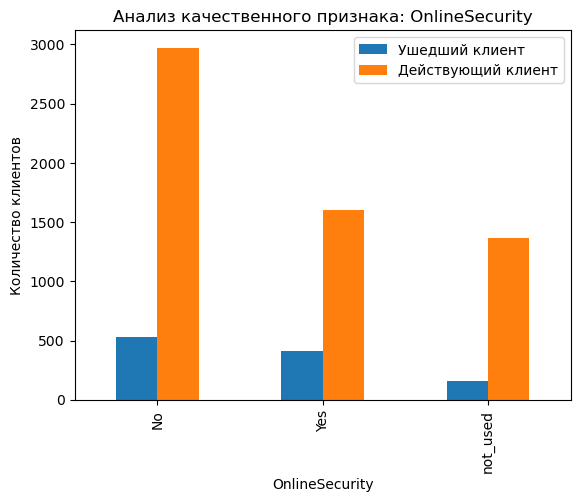

,Ушедший клиент,% от ушедших,Действующий клиент,% от действующих
OnlineSecurity,,,,
No,526,47.77,2972,50.02
Yes,415,37.69,1604,26.99
not_used,160,14.53,1366,22.99


In [58]:
left_actual_df_cat(df, 'OnlineSecurity')

В группе действующих клиентов услуга блокировки небезопасных сайтов более популярна.

OnlineBackup

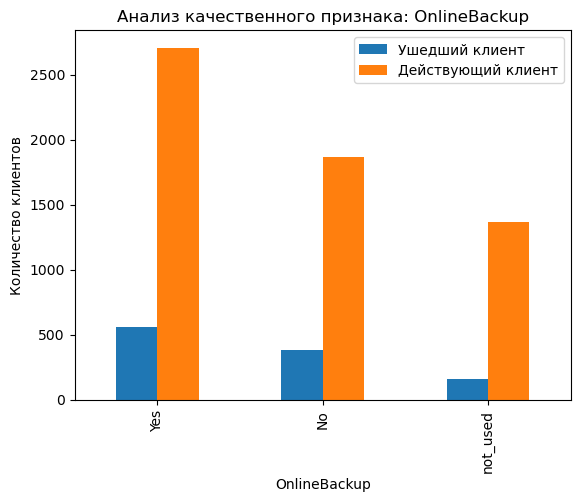

,Ушедший клиент,% от ушедших,Действующий клиент,% от действующих
OnlineBackup,,,,
Yes,560,50.86,2707,45.56
No,381,34.60,1869,31.45
not_used,160,14.53,1366,22.99


In [59]:
left_actual_df_cat(df, 'OnlineBackup')

DeviceProtection

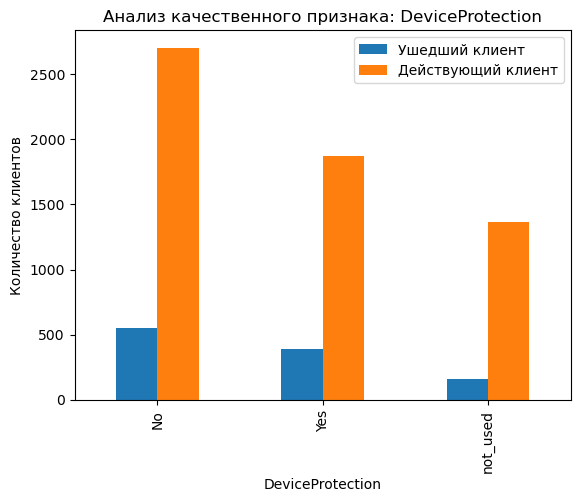

,Ушедший клиент,% от ушедших,Действующий клиент,% от действующих
DeviceProtection,,,,
No,550,49.95,2704,45.51
Yes,391,35.51,1872,31.50
not_used,160,14.53,1366,22.99


In [60]:
left_actual_df_cat(df, 'DeviceProtection')

TechSupport

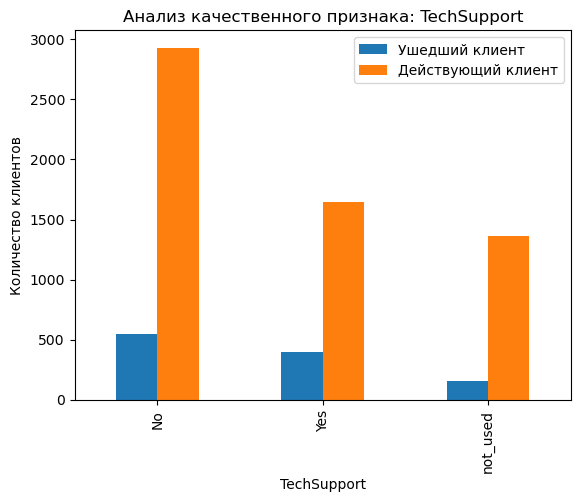

,Ушедший клиент,% от ушедших,Действующий клиент,% от действующих
TechSupport,,,,
No,543,49.32,2930,49.31
Yes,398,36.15,1646,27.70
not_used,160,14.53,1366,22.99


In [61]:
left_actual_df_cat(df, 'TechSupport')

Услугой выделенной линии технической поддержки реже пользуются обе категории. 

StreamingTV

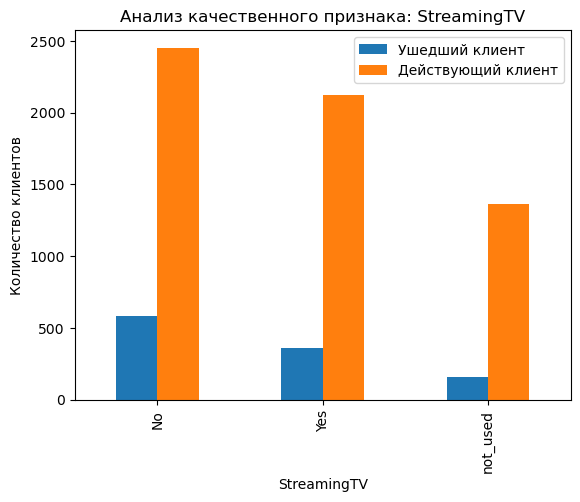

,Ушедший клиент,% от ушедших,Действующий клиент,% от действующих
StreamingTV,,,,
No,584,53.04,2453,41.28
Yes,357,32.43,2123,35.73
not_used,160,14.53,1366,22.99


In [62]:
left_actual_df_cat(df, 'StreamingTV')

StreamingMovies

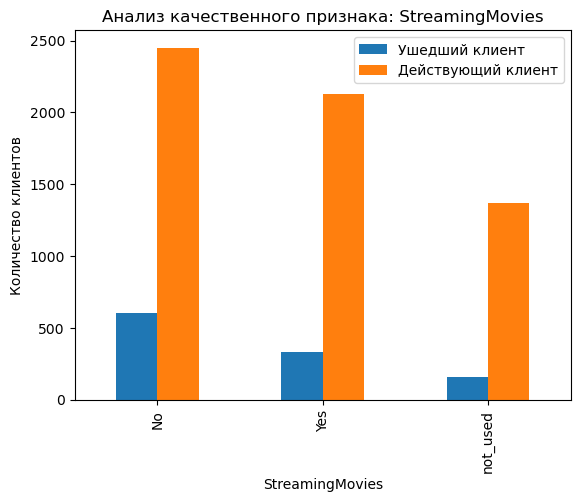

,Ушедший клиент,% от ушедших,Действующий клиент,% от действующих
StreamingMovies,,,,
No,606,55.04,2450,41.23
Yes,335,30.43,2126,35.78
not_used,160,14.53,1366,22.99


In [63]:
left_actual_df_cat(df, 'StreamingMovies')

Услуги, связанные со стриминговым телевидением, популярнее у действующих клиентов. 

MultipleLines

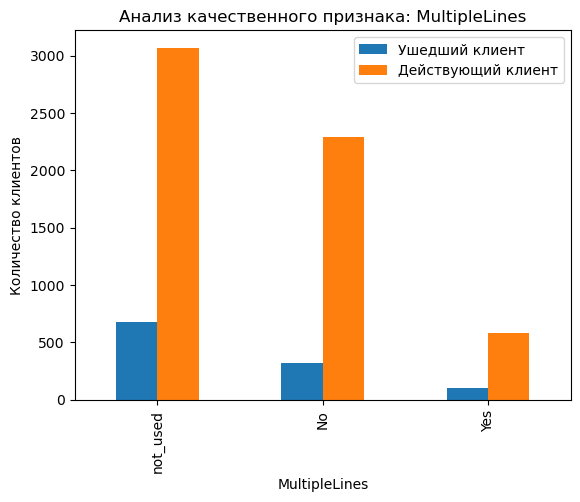

,Ушедший клиент,% от ушедших,Действующий клиент,% от действующих
MultipleLines,,,,
not_used,678,61.58,3070,51.67
No,320,29.06,2293,38.59
Yes,103,9.36,579,9.74


In [64]:
left_actual_df_cat(df, 'MultipleLines')

In [65]:
# функция для анализа количественных признаков
def left_actual_df_cat_num(df, column):
    left = df[df['Churn'] == 1][column].values
    actual = df[df['Churn'] == 0][column].values
    df = pd.DataFrame(index=['min', 'max', 'avg'], data={'Ушедший клиент': [round(left.min(),2), 
                                                                            round(left.max(),2), 
                                                                            round(left.mean(), 2)], 
                                                          'Действующий клиент': [round(actual.min(), 2),
                                                                                 round(actual.max(), 2), 
                                                                                 round(actual.mean(), 2)]})
    df.index.name = column
    return df

MonthlyCharges

In [66]:
left_actual_df_cat_num(df, 'MonthlyCharges')

,Ушедший клиент,Действующий клиент
MonthlyCharges,,
min,18.40,18.25
max,118.75,118.60
avg,75.55,62.76


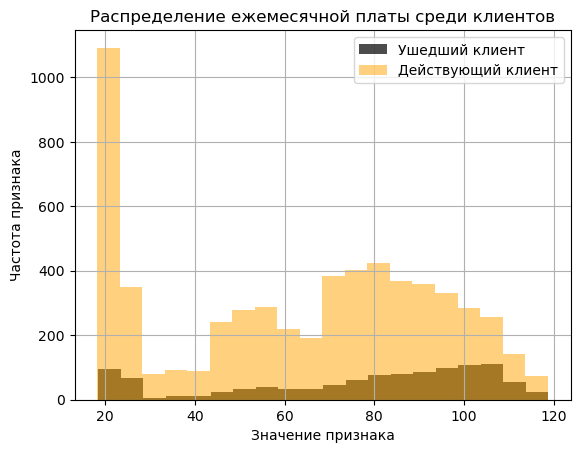

In [67]:
def plot_histogram(df, column):
    fig, ax = plt.subplots()
    df[df['Churn'] == 1][column].hist(bins=20, color='black', alpha=0.7, label='Ушедший клиент')
    df[df['Churn'] == 0][column].hist(bins=20, color='orange', alpha=0.5, label='Действующий клиент')
    ax.set_title('Распределение ежемесячной платы среди клиентов')
    ax.set_xlabel('Значение признака')
    ax.set_ylabel('Частота признака')
    ax.legend()
    plt.show()

plot_histogram(df, 'MonthlyCharges')

Мы видим, что минимальные и средние платежи распределены примерно одинаково у ушедших и действующих клиентов, однако среди действующих клиентов гораздо больше тех, кто платит больше 70 долларов в месяц.

TotalCharges

In [68]:
def left_actual_df_cat_nums(df, column):
    left = df[df['Churn'] == 1][column].values
    actual = df[df['Churn'] == 0][column].values
    unique_left = np.unique(left) 
    sorted_unique_left = np.sort(unique_left)  
    second_min_left = sorted_unique_left[1]  # Второе уникальное минимальное значение
    unique_actual = np.unique(actual)  
    sorted_unique_actual = np.sort(unique_actual)  
    second_min_actual = sorted_unique_actual[1]  # Второе уникальное минимальное значение
    df = pd.DataFrame(index=['min', 'max', 'avg'], data={'Ушедший клиент': [round(left.min(), 2),
                                                                            round(left.max(), 2),
                                                                            round(left.mean(), 2)],
                                                          'Действующий клиент': [round(actual.min(), 2),
                                                                                 round(actual.max(), 2),
                                                                                 round(actual.mean(), 2)]})
    df.loc['min', 'Ушедший клиент'] = round(second_min_left, 2)  # Замена значения минимума на второе уникальное минимальное
    df.loc['min', 'Действующий клиент'] = round(second_min_actual, 2)  # Замена значения минимума на второе уникальное минимальное
    df.index.name = column
    return df

Перебрал код для более точных данных по минимуму

In [69]:
left_actual_df_cat_nums(df, 'TotalCharges')

,Ушедший клиент,Действующий клиент
TotalCharges,,
min,80.95,19.05
max,7649.76,9221.38
avg,2371.38,2067.87


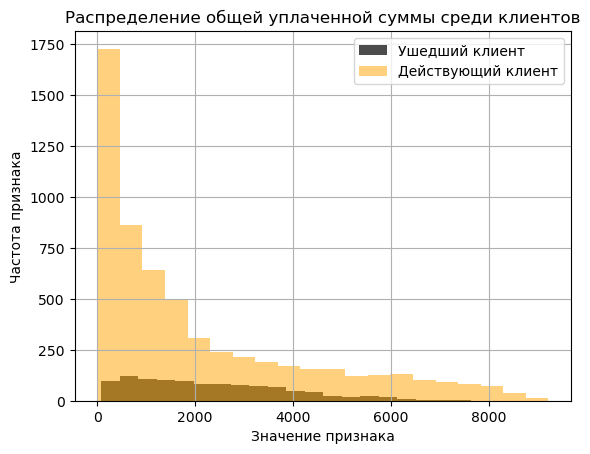

In [70]:
def plot_histograms(df, column):
    fig, ax = plt.subplots()
    df[df['Churn'] == 1][column].hist(bins=20, color='black', alpha=0.7, label='Ушедший клиент')
    df[df['Churn'] == 0][column].hist(bins=20, color='orange', alpha=0.5, label='Действующий клиент')
    ax.set_title('Распределение общей уплаченной суммы среди клиентов')
    ax.set_xlabel('Значение признака')
    ax.set_ylabel('Частота признака')
    ax.legend()
    plt.show()

plot_histograms(df, 'TotalCharges')

В то время как минимальные и максимальные значения общей уплаченной суммы в разрезе категорий клиентов схожи, средняя сумма всех платежей у ушедших клиентов меньше, что связано с тем, что среди действующих клиентов гораздо больше клиентов с общей суммой платежа более 1000 долларов, что опять же можно связать с большим ежемесячным платежом в среднем.

ContractTerm

In [71]:
left_actual_df_cat_nums(df, 'ContractTerm')

,Ушедший клиент,Действующий клиент
ContractTerm,,
min,30.00,31.00
max,2129.00,2314.00
avg,924.86,893.68


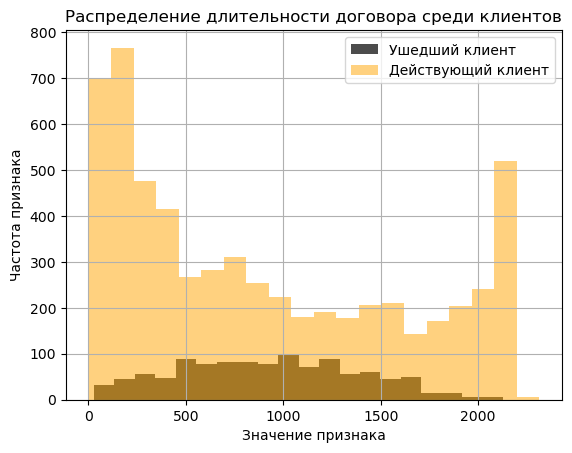

In [72]:
def plot_histogramt(df, column):
    fig, ax = plt.subplots()
    df[df['Churn'] == 1][column].hist(bins=20, color='black', alpha=0.7, label='Ушедший клиент')
    df[df['Churn'] == 0][column].hist(bins=20, color='orange', alpha=0.5, label='Действующий клиент')
    ax.set_title('Распределение длительности договора среди клиентов')
    ax.set_xlabel('Значение признака')
    ax.set_ylabel('Частота признака')
    ax.legend()
    plt.show()

plot_histogramt(df, 'ContractTerm')

Видим, что  распределение срока действия прямо противоположные. Исходя из графиков, клиенты уходят либо почти сразу (в течение одного-полутора лет) либо после 2000 дней пользования услугами компании. В то же время между этими значениями большинство клиентов являются действующими.

**Вывод**

По результатам подробного анализа наибольшие различия значений между ушедшими и действующими клиентами выявлены среди признаков ежемесячного платежа и общей суммы платежа, а также срока действия договора с клиентом.

**Проверка корреляции признаков**

Удалим признак EndDate, т. к. он использовался для создания целевого признака и BeginDate как непригодный для машинного обучения в этом проекте.

In [73]:
df = df.drop(columns=['EndDate', 'BeginDate'])

Корреляцию будем оценивать с помощью 'Phi-k' корреляции, способную работать с категориальными и порядковыми переменными, а также улавливающую нелинейную зависимость.

In [74]:
# отберем признаки, которые будем анализировать
columns_to_analize = ['Type', 'PaperlessBilling', 'PaymentMethod',
       'MonthlyCharges', 'TotalCharges', 'gender', 'SeniorCitizen', 'Partner',
       'Dependents', 'InternetService', 'OnlineSecurity', 'OnlineBackup',
       'DeviceProtection', 'TechSupport', 'StreamingTV', 'StreamingMovies',
       'MultipleLines', 'Churn', 'ContractTerm']
# укажем интервальные признаки
interval_columns = ['MonthlyCharges', 'TotalCharges', 'ContractTerm']
# построим матрицу корреляции
phik_overview = df[columns_to_analize].phik_matrix(interval_cols=interval_columns)

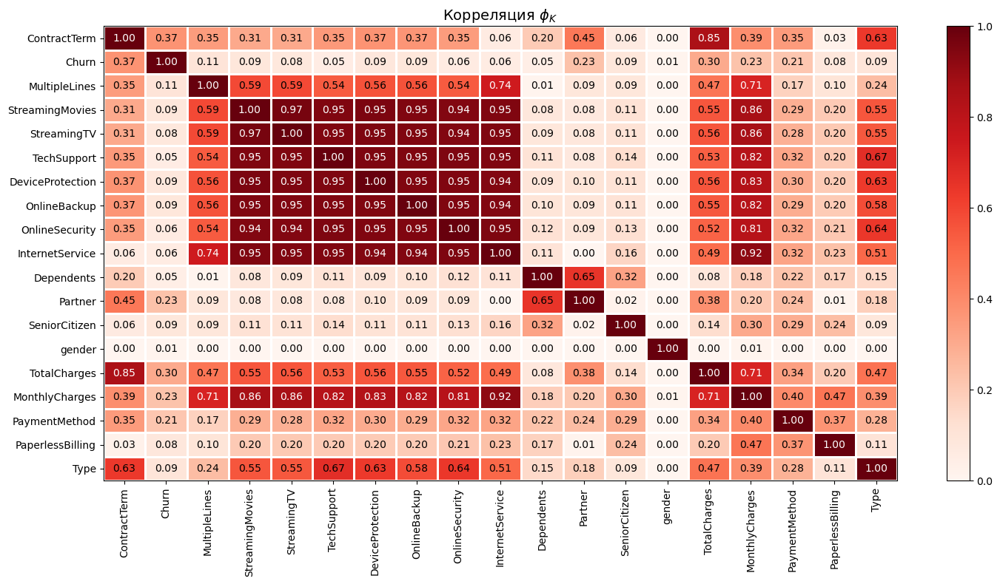

In [75]:
# построим тепловой график корреляции
plot_correlation_matrix(phik_overview.values, 
                        x_labels=phik_overview.columns, 
                        y_labels=phik_overview.index, 
                        vmin=0, vmax=1, color_map="Reds", 
                        title=r"Корреляция $\phi_K$", 
                        fontsize_factor=1, 
                        figsize=(15, 8))
plt.tight_layout()

Мы видим, что существует высокая корреляция между признаками:

1. ContractTerm и TotalCharges.

2. MultipleLines и InternetService.

3. Между всеми признаками из файла internet_new, а также ими и параметром MonthlyCharges.

4. TotalCharges и MonthlyCharges.


Для решения проблемы мультиколлинеарности проведем следующие изменения:

1. Удалим столбцы TotalCharges, оставив столбец ContractTerm.

2. Удалим все признаки, связанные с интернетом. Сделаем предположение, что параметр MonthlyCharges отражает набор используемых услуг.

3. Заменим столбец MultipleLines на столбец Phone, обозначающий, пользуется клиент телефоном или нет.

4. Также удалим столбец customerID, т. к. он не несет полезной информации.

Создадим столбец Phone:

In [76]:
df.loc[df['MultipleLines'] == 'Yes', 'Phone'] = 1
df.loc[(df['MultipleLines'] == 'not_used') | (df['MultipleLines'] == 'No'), 'Phone'] = 0
df['Phone'] = df['Phone'].astype('int')

Проверим заполнение:

In [77]:
df['Phone'].value_counts()

0    4072
1    2971
Name: Phone, dtype: int64

In [78]:
df['MultipleLines'].value_counts()

No          3390
Yes         2971
not_used     682
Name: MultipleLines, dtype: int64

Столбец заполнен корректно.

Удалим лишние столбцы:

In [79]:
df_f = df.drop(columns=['customerID', 'TotalCharges', 'InternetService', 'OnlineSecurity', 
                          'OnlineBackup', 'DeviceProtection', 'TechSupport', 'StreamingTV', 'StreamingMovies',
                          'MultipleLines'])

Повторно проверим признаки на мультиколлинеарность:

In [80]:
interval_columns_2 = ['MonthlyCharges', 'ContractTerm']

phik_overview_2 = df_f.phik_matrix(interval_cols=interval_columns_2)

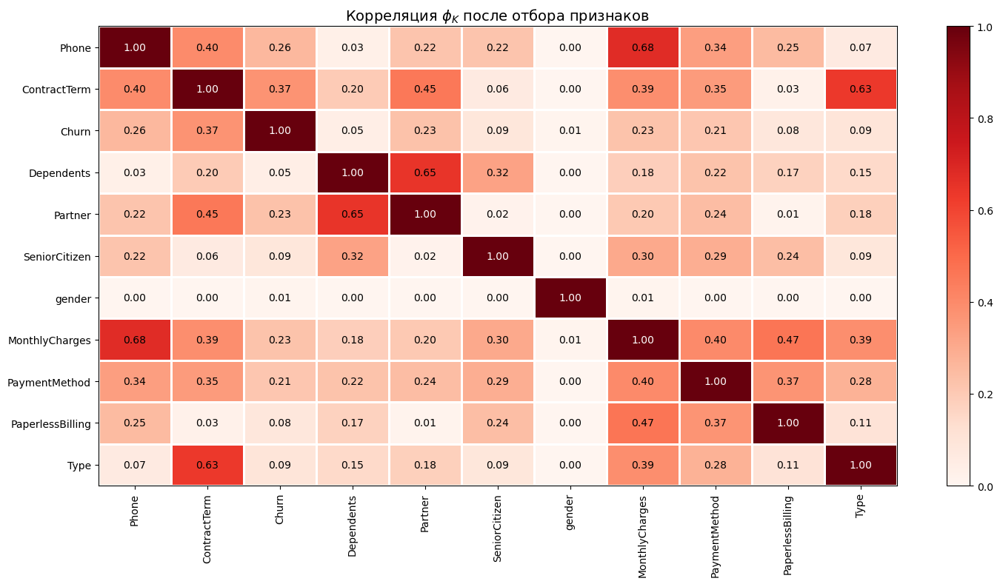

In [81]:
# построим график
plot_correlation_matrix(phik_overview_2.values, 
                        x_labels=phik_overview_2.columns, 
                        y_labels=phik_overview_2.index, 
                        vmin=0, vmax=1, color_map="Reds", 
                        title=r"Корреляция $\phi_K$ после отбора признаков", 
                        fontsize_factor=1, 
                        figsize=(15, 8))
plt.tight_layout()

После обработки мультиколлинеарность признаков не превышает критическое значение. Продолжим работу с данным датасетом.

**Разделение датасета**

Посмотрим на финальный датасет:

In [82]:
df_f.head()

,Type,PaperlessBilling,PaymentMethod,MonthlyCharges,gender,SeniorCitizen,Partner,Dependents,Churn,ContractTerm,Phone
0,Month-to-month,Yes,Electronic check,29.85,Female,0,Yes,No,0,31,0
1,One year,No,Mailed check,56.95,Male,0,No,No,0,1036,0
2,Month-to-month,Yes,Mailed check,53.85,Male,0,No,No,0,123,0
3,One year,No,Bank transfer (automatic),42.30,Male,0,No,No,0,1371,0
4,Month-to-month,Yes,Electronic check,70.70,Female,0,No,No,0,153,0


Разделим датасет на target и features:

In [83]:
y = df_f['Churn']
X = df_f.drop(columns='Churn')

Разделим датасет на обучающую и тестовую выборки:

In [84]:
# сохраним пропорцию целевого признака в обучающей и тестовой выборках
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=RANDOM_STATE, stratify=y)

Проверим разделение на выборки:

In [85]:
print('Размер обучающих выборок:', X_train.shape, y_train.shape)
print('Размер тестовых выборок:', X_test.shape, y_test.shape)

Размер обучающих выборок: (5282, 10) (5282,)
Размер тестовых выборок: (1761, 10) (1761,)


In [86]:
print('Доля положительного признака в таргете:', round(y_train.value_counts()[1] / len(y_train), 2), 'и', 
                                                 round(y_test.value_counts()[1] / len(y_test), 2))

print('Доля отрицательного признака в таргете:', round(y_train.value_counts()[0] / len(y_train), 2), 'и', 
                                                 round(y_test.value_counts()[0] / len(y_test), 2))

Доля положительного признака в таргете: 0.16 и 0.16
Доля отрицательного признака в таргете: 0.84 и 0.84


Выборки распределены корректно.

**Вывод**

Предобработка датасета завершена. Можно переходить к обучению моделей. Вопросов нету.

Далее планирую обучение моделей на логистической регрессии, случайном лесу, LightGBM и выбрать наилучшею модель   

## Обучение моделей

В данном разделе мы будем обучать модели, такие как логистическая регрессия, случайный лес и LightGBM. Обучение будет проводиться с использованием пайплайнов, где признаки будут кодироваться внутри трансформеров, чтобы избежать утечки информации о признаках. Оценка метрик будет проводиться с использованием кросс-валидации.

**Логистическая регрессия**

Для логистической регрессии и случайного леса мы будем использовать метод кодирования категориальных признаков One-Hot Encoding (OHE). Кроме того, для логистической регрессии мы также проведем масштабирование признаков.

In [87]:
# категориальные признаки для OHE
categorical_features = ['Type', 'PaperlessBilling', 'PaymentMethod', 'gender', 
                        'SeniorCitizen', 'Partner', 'Dependents', 'Phone']

# количественные признаки для масштабирования
num_features = ['MonthlyCharges', 'ContractTerm']

In [88]:
# создаем трансформер для обработки колонок
col_transformer_lr = make_column_transformer(
    (
        OneHotEncoder(drop='first', handle_unknown='error'),
        categorical_features
    ),
    (
        StandardScaler(),
        num_features
    )
)

In [89]:
# пайплайн для логистической регрессии
pipe_lr = Pipeline([
    ('col_transf', col_transformer_lr),
    ('lr_model', LogisticRegression(random_state=RANDOM_STATE))
])

In [90]:
# получим время обучения логистической регрессии
start = time.time()

pipe_lr.fit(X_train, y_train)

end = time.time()
lr_fit_time = end - start
print('Время обучения логистической регрессии:', round(lr_fit_time, 2), 'с')

Время обучения логистической регрессии: 0.06 с


In [91]:
roc_auc_lr = cross_val_score(pipe_lr, X_train, y_train, scoring='roc_auc', cv=5, n_jobs=-1).mean()
print('ROC-AUC модели логистической регрессии:', round(roc_auc_lr, 2))

ROC-AUC модели логистической регрессии: 0.74


In [92]:
# время предсказания логистической регрессии
start = time.time()

pipe_lr.predict(X_train)

end = time.time()
lr_pred_time = end - start
print('Время предсказания логистической регрессии:', round(lr_pred_time, 2), 'с')

Время предсказания логистической регрессии: 0.02 с


Выведем сводную информацию по модели логистической регрессии:

In [93]:
lr_results = pd.DataFrame({'Название модели': ['Логистическая регрессия'],
                           'ROC-AUC': [roc_auc_lr],
                           'Время обучения, с': [lr_fit_time],
                           'Время предсказания, с': [lr_pred_time],
                           'Используемые гиперпараметры': ['н/п']})
lr_results = lr_results.set_index('Название модели')
lr_results.style.format({'Время обучения, с': '{:.4f}', 'Время предсказания, с': '{:.4f}', 'ROC-AUC': '{:.4f}'})

,ROC-AUC,"Время обучения, с","Время предсказания, с",Используемые гиперпараметры
Название модели,,,,
Логистическая регрессия,0.7399,0.0631,0.0245,н/п


**Случайный лес**

In [94]:
# Определить конвейер и трансформер
categorical_features = ['Type', 'PaperlessBilling', 'PaymentMethod', 'gender', 
                        'SeniorCitizen', 'Partner', 'Dependents', 'Phone']  # Список имен категориальных признаков
preprocessor = ColumnTransformer([
    ('encoder', OneHotEncoder(), categorical_features)
], remainder='passthrough')

pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('classifier', RandomForestClassifier(random_state=RANDOM_STATE))
])

# Определить сетку параметров для GridSearchCV
param_grid = {
    'classifier__n_estimators': [100, 200, 300],
    'classifier__max_depth': [None, 5, 10],
    'classifier__min_samples_split': [2, 5, 10]
}

# Выполнить поиск по сетке с использованием кросс-валидации
grid_search = GridSearchCV(pipeline, param_grid, cv=5, scoring='roc_auc')
grid_search.fit(X_train, y_train)

# Получить лучшую модель и её параметры
best_model = grid_search.best_estimator_
best_params = grid_search.best_params_

# Вычислить значение ROC-AUC на обучающей выборке с помощью кросс-валидации
roc_auc_cv = grid_search.best_score_

# Добавьте результаты в таблицу
roc_auc_rf = pd.DataFrame({'Название модели': ['Random Forest'],
                       'ROC-AUC (CV)': [roc_auc_cv],
                       'Лучшие параметры': [best_params],
                       'Используемые гиперпараметры': ['н/п']})
roc_auc_rf = roc_auc_rf.set_index('Название модели')

# Вывести таблицу результатов
roc_auc_rf

,ROC-AUC (CV),Лучшие параметры,Используемые гиперпараметры
Название модели,,,
Random Forest,0.812066,"{'classifier__max_depth': 10, 'classifier__min...",н/п


In [95]:
print('ROC-AUC модели случайного леса:', round(roc_auc_rf, 2))

ROC-AUC модели случайного леса:                  ROC-AUC (CV)  \
Название модели                 
Random Forest            0.81   

                                                  Лучшие параметры  \
Название модели                                                      
Random Forest    {'classifier__max_depth': 10, 'classifier__min...   

                Используемые гиперпараметры  
Название модели                              
Random Forest                           н/п  


In [96]:
# пайплайн для Random Forest с лучшими параметрами
pipe_rf = Pipeline([
    ('encoder', OneHotEncoder(drop='first', handle_unknown='error')),
    ('rf_model', RandomForestClassifier(max_depth=best_params['classifier__max_depth'], 
                                        n_estimators=best_params['classifier__n_estimators'], 
                                        random_state=RANDOM_STATE))
])

In [97]:
start = time.time()

pipe_rf.fit(X_train, y_train)

end = time.time()
rf_fit_time = end - start
print('Время обучения случайного дерева:', round(rf_fit_time, 2), 'с')

Время обучения случайного дерева: 0.81 с


In [98]:
start = time.time()

pipe_rf.predict(X_train)

end = time.time()
rf_pred_time = end - start
print('Время предсказания случайного дерева:', round(rf_pred_time, 4), 'с')

Время предсказания случайного дерева: 0.2253 с


In [99]:
rf_results = pd.DataFrame({'Название модели': ['Случайный лес'],
                           'ROC-AUC': [roc_auc_cv],
                           'Время обучения, с': [rf_fit_time],
                           'Время предсказания, с': [rf_pred_time],
                           'Используемые гиперпараметры': [best_params]})
rf_results = rf_results.set_index('Название модели')
rf_results_styled = rf_results.style.format({'Время обучения, с': '{:.4f}s', 'Время предсказания, с': '{:.4f}s', 'ROC-AUC': '{:.4f}'})

In [100]:
rf_results

,ROC-AUC,"Время обучения, с","Время предсказания, с",Используемые гиперпараметры
Название модели,,,,
Случайный лес,0.812066,0.807276,0.225277,"{'classifier__max_depth': 10, 'classifier__min..."


**LightGBM**

In [101]:
# для модели градиентного бустинга изменим в датасетах тип качественных признаков на categorical
X_train_cat = X_train.copy()
X_test_cat = X_test.copy()

for dataset in [X_train_cat, X_test_cat]:
    for column in categorical_features:
        dataset[column] = dataset[column].astype('category')

Проверим корректность конвертации:

In [102]:
X_train_cat.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5282 entries, 1382 to 705
Data columns (total 10 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   Type              5282 non-null   category
 1   PaperlessBilling  5282 non-null   category
 2   PaymentMethod     5282 non-null   category
 3   MonthlyCharges    5282 non-null   float64 
 4   gender            5282 non-null   category
 5   SeniorCitizen     5282 non-null   category
 6   Partner           5282 non-null   category
 7   Dependents        5282 non-null   category
 8   ContractTerm      5282 non-null   int64   
 9   Phone             5282 non-null   category
dtypes: category(8), float64(1), int64(1)
memory usage: 166.1 KB


In [103]:
gb_model = lgb.LGBMClassifier(random_state=RANDOM_STATE, 
                              importance_type='gain')

param_grid_gb = [
   {'num_leaves': [3, 4, 5], 
    'learning_rate': [0.26, 0.27, 0.28],
    'n_estimators': [600, 650, 700],
    'reg_alpha': [0.1, 0.15, 0.2],
    'reg_lambda': [0.5, 0.55, 0.6],
    'max_depth': [23, 24, 25],
    'subsample_for_bin': [3000, 3500, 4000],
    'min_data_in_leaf': [1, 10, 100]
   }]

grid_gb = GridSearchCV(gb_model,
                     param_grid_gb,
                     scoring='roc_auc',
                     cv=3,
                     verbose=0,
                     refit=True)

grid_gb.fit(X_train_cat, y_train)

[LightGBM] [Warning] min_data_in_leaf is set=1, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1
[LightGBM] [Warning] min_data_in_leaf is set=1, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1
[LightGBM] [Info] Number of positive: 551, number of negative: 2970
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001559 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 430
[LightGBM] [Info] Number of data points in the train set: 3521, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.156490 -> initscore=-1.684582
[LightGBM] [Info] Start training from score -1.684582
[LightGBM] [Warning] min_data_in_leaf is set=1, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1
[LightGBM] [Warning] min_data_in_leaf is set=1, min_child_samples=20 will be ignored. C

GridSearchCV(cv=3,
             estimator=LGBMClassifier(importance_type='gain',
                                      random_state=11092023),
             param_grid=[{'learning_rate': [0.26, 0.27, 0.28],
                          'max_depth': [23, 24, 25],
                          'min_data_in_leaf': [1, 10, 100],
                          'n_estimators': [600, 650, 700],
                          'num_leaves': [3, 4, 5],
                          'reg_alpha': [0.1, 0.15, 0.2],
                          'reg_lambda': [0.5, 0.55, 0.6],
                          'subsample_for_bin': [3000, 3500, 4000]}],
             scoring='roc_auc')

In [104]:
grid_gb.best_params_

{'learning_rate': 0.28,
 'max_depth': 23,
 'min_data_in_leaf': 1,
 'n_estimators': 700,
 'num_leaves': 3,
 'reg_alpha': 0.2,
 'reg_lambda': 0.5,
 'subsample_for_bin': 4000}

In [105]:
# обучение модели с лучшими параметрами
gb_model = lgb.LGBMClassifier(**grid_gb.best_params_, random_state=RANDOM_STATE)

In [106]:
# время обучения
start = time.time()

gb_model.fit(X_train_cat, y_train)

end = time.time()
gb_fit_time = end - start
print('Время обучения градиентного бустинга:', round(gb_fit_time, 4), 'с')

[LightGBM] [Warning] min_data_in_leaf is set=1, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1
[LightGBM] [Warning] min_data_in_leaf is set=1, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1
[LightGBM] [Info] Number of positive: 826, number of negative: 4456
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000248 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 439
[LightGBM] [Info] Number of data points in the train set: 5282, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.156380 -> initscore=-1.685412
[LightGBM] [Info] Start training from score -1.685412
Время обучения градиентного бустинга: 0.1401 с


In [107]:
start = time.time()

predictions = gb_model.predict(X_train_cat)

end = time.time()
gb_pred_time = end - start
print('Время предсказания градиентного бустинга:', round(gb_pred_time, 4), 'с')

[LightGBM] [Warning] min_data_in_leaf is set=1, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1
Время предсказания градиентного бустинга: 0.0565 с


In [108]:
roc_auc_gb = grid_gb.best_score_
print('ROC-AUC модели градиентного бустинга:', round(roc_auc_gb, 4))

ROC-AUC модели градиентного бустинга: 0.8984


In [109]:
gb_results = pd.DataFrame({'Название модели': ['LightGBM'],
                           'ROC-AUC': [roc_auc_gb],
                           'Время обучения, с': [gb_fit_time],
                           'Время предсказания, с': [gb_pred_time],
                           'Используемые гиперпараметры': [grid_gb.best_params_]})
gb_results = gb_results.set_index('Название модели')
gb_results.style.format({'Время обучения, с': '{:.4f}', 'Время предсказания, с': '{:.4f}', 'ROC-AUC': '{:.4f}'})

,ROC-AUC,"Время обучения, с","Время предсказания, с",Используемые гиперпараметры
Название модели,,,,
LightGBM,0.8984,0.1401,0.0565,"{'learning_rate': 0.28, 'max_depth': 23, 'min_data_in_leaf': 1, 'n_estimators': 700, 'num_leaves': 3, 'reg_alpha': 0.2, 'reg_lambda': 0.5, 'subsample_for_bin': 4000}"


**Вывод**

Построим сводную таблицу с результатами обучения моделей:

In [110]:
summary_results = pd.concat([lr_results, rf_results, gb_results])

In [111]:
summary_results 

,ROC-AUC,"Время обучения, с","Время предсказания, с",Используемые гиперпараметры
Название модели,,,,
Логистическая регрессия,0.739943,0.063137,0.024479,н/п
Случайный лес,0.812066,0.807276,0.225277,"{'classifier__max_depth': 10, 'classifier__min..."
LightGBM,0.898435,0.140129,0.056545,"{'learning_rate': 0.28, 'max_depth': 23, 'min_..."


Мы видим, что лучшие результаты показали модели логистической регрессии и градиентного бустинга, при этом скорость работы модели градиентного бустинга также немного выше. В следующем разделе проверим эту модель на тестовой выборке.

**Проверка лучшей модели на тестовой выборке**

Сделаем предсказания по тестовой выборке с помощью модели градиентного бустинга и посчитаем метрику ROC-AUC:

In [112]:
predictions_test = gb_model.predict(X_test_cat)
probabilities_test = gb_model.predict_proba(X_test_cat)
print('Метрика ROC-AUC на тестовой выборке:', round(roc_auc_score(y_test, probabilities_test[:, 1]), 4))

[LightGBM] [Warning] min_data_in_leaf is set=1, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1
[LightGBM] [Warning] min_data_in_leaf is set=1, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1
Метрика ROC-AUC на тестовой выборке: 0.9261


Отобразим кривую ROC на графике:

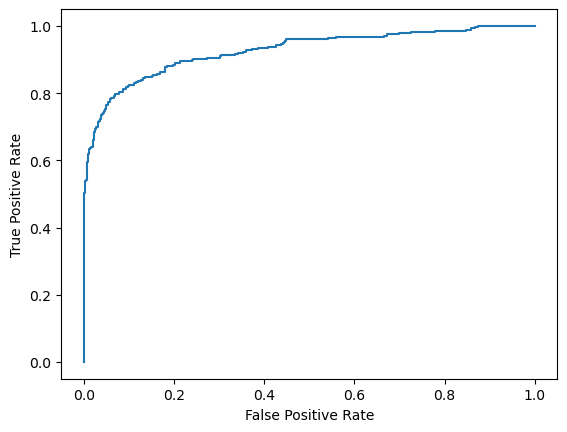

In [113]:
from sklearn.metrics import roc_curve, auc
fpr, tpr, thresholds = roc_curve(y_test, probabilities_test[:, 1])

roc_display = RocCurveDisplay(fpr=fpr, tpr=tpr)
roc_display.plot()

plt.show()

Хорошую модель обычно характеризует ROC-кривая, близкая к верхнему левому углу графика (у нас как раз такая), что соответствует более высокому TPR и более низкому FPR. Это означает, что модель способна достичь высокой доли верно положительных случаев при минимизации количества ложно положительных случаев. Иными словами, модель эффективно идентифицирует положительные случаи, минимизируя количество ложных срабатываний.

Построим матрицу ошибок, а также нормализованную матрицу:

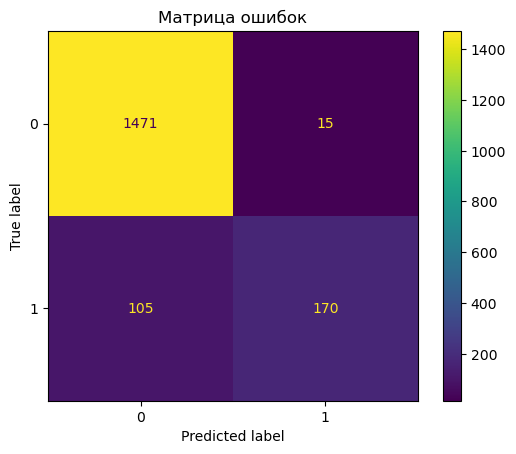

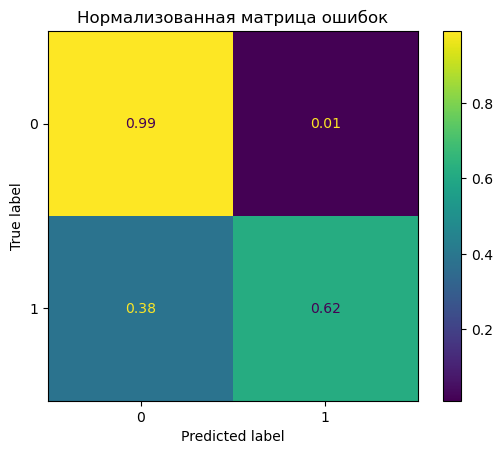

In [114]:
from sklearn.metrics import ConfusionMatrixDisplay, confusion_matrix

# Расчет матрицы ошибок
cm = confusion_matrix(y_test, predictions_test)

# Создание экземпляра ConfusionMatrixDisplay и построение матрицы ошибок
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['0', '1'])
disp.plot()

plt.title('Матрица ошибок')
plt.show()

# Нормализация матрицы ошибок
cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

# Создание экземпляра ConfusionMatrixDisplay и построение нормализованной матрицы ошибок
disp_normalized = ConfusionMatrixDisplay(confusion_matrix=cm_normalized, display_labels=['0', '1'])
disp_normalized.plot()

plt.title('Нормализованная матрица ошибок')
plt.show()

Из представленных графиков можно сделать вывод, что модель имеет высокую чувствительность (TPR) в 0.99 при низкой специфичности (TNR) в 0.61. Это означает, что модель лучше предсказывает клиентов, которые ушли, чем тех, у кого контракт еще действует. Другими словами, 39% клиентов, которые фактически не собираются уходить, будут неправильно классифицированы моделью как клиенты, с которыми нужно провести работу по удержанию. Эти результаты можно объяснить тем, что в обучающей выборке присутствует неравновесие классов, где ушедшие клиенты представлены лучше.

Для улучшения работы модели на реальных данных рекомендуется обучать ее на данных, которые являются репрезентативными и балансированными по классам. Например, можно использовать данные только по действующим клиентам на определенный момент времени в прошлом и пометить как ушедших тех клиентов, у которых известно, что они не продлили договор на текущую дату. Это позволит модели лучше учитывать баланс классов и давать более точные предсказания.

Также посмотрим на важность параметров в модели:

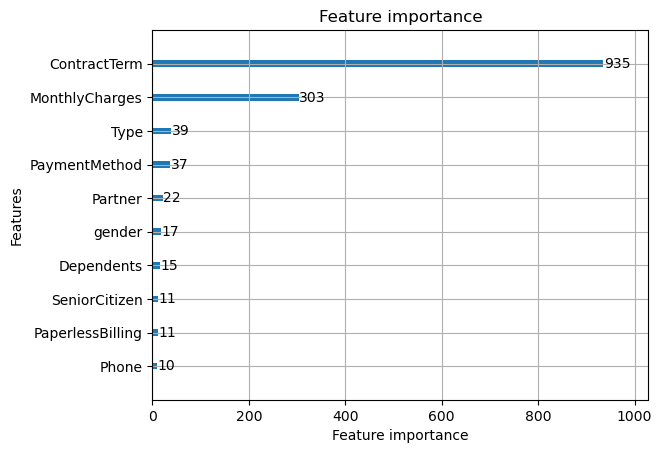

In [115]:
lgb.plot_importance(gb_model)
plt.show()

Как показано на графике выше, наиболее важными факторами, влияющими на лояльность клиента, являются срок действия контракта, то есть сколько времени клиент уже пользуется услугами компании, а также размер ежемесячной платы и тип оплаты. Это подтверждается результатами исследования признаков, проведенного ранее, где были выявлены наибольшие различия между ушедшими и действующими клиентами именно по этим параметрам.

**Вывод**

В рамках данного проекта мы провели анализ данных клиентов компании "Ниединогоразрыва.ком" с целью предсказания оттока клиентов.

Мы проанализировали и обработали полученные данные, и на их основе обучили несколько моделей классификации. После проведения кросс-валидации мы выбрали лучшую модель - LightGBM, которая показала показатель ROC-AUC на тестовой выборке равный 0.93.

Однако, модель показывает лучшие результаты в предсказании ушедших клиентов, чем оставшихся. Это связано с дисбалансом классов в обучающей выборке. Для улучшения модели мы рекомендуем обучать ее на датасете, который более точно отражает баланс классов клиентов в конкретный момент времени. Подробнее об этом описано в предыдущем разделе.

Наиболее важными параметрами, которые влияют на отток клиентов, являются "Длительность обслуживания клиента данной компанией", "Размер ежемесячной платы" и "Тип оплаты".

Таким образом, мы успешно выполнены поставленные задачи и достигли цели данного проекта.

## Отчет по проекту 

В данном разделе описаны ключевые этапы проекта.

**Анализ выполнения плана проекта**

В данном разделе приведен анализ выполнения плана проекта, составленного на этапе исследовательского анализа данных.

Изначальный план содержал в себе следующие пункты:

1. Обработать сводный датасет и подготовить его к обучению модели.

2. Выбрать столбцы (параметры), актуальные для обучения модели, при необходимости создать новые.

3. Разделить данные на обучающую и тестовую выборки.

4. Обучить несколько моделей классификации и сравнить их показатели на кросс-валидации по обучающей выборке.

5. Выбрать лучшую модель, проверить ее качество на тестовой выборке и представить результаты.


Все указанные выше изначально запланированные этапы работы были выполнены.

Также был проведен анализ всех признаков датасета в разрезе ушедших и оставшихся клиентов для более полного понимания данных, их стуктуры и взаимосвязи. Кроме того был проведен анализ на корреляцию признаков для избежания мультиколлинеарности, по результатом которого из датасета были удалены сильно коррелирующие друг с другом признаки.

**Трудности, возникшие при выполнении проекта**

Наиболее сложным этапом проекта было достижение наибольшей метрики лучшей модели (LightGBM), а также избежание переобучения модели.

Для достижения наилучшей метрики модели и предотвращения переобучения был проведен тщательный анализ признаков, на которых обучается модель, а также подбор гиперпараметров модели в несколько итераций.

*Анализ признаков и подбор гиперпараметров*

На начальном этапе были определены основные параметры модели, и с помощью GridSearch были выявлены их примерные значения, на которых метрика на кросс-валидации показывала наилучший результат. Затем были добавлены остальные параметры, включая те, которые помогали справиться с переобучением.

После подбора приблизительных значений параметров были подобраны наиболее точные значения, которые позволили улучшить итоговую метрику. Для ускорения процесса подбора значений параметров они фиксировались поочередно, а затем осуществлялся подбор следующего параметра.

На финальном этапе был проведен совместный подбор на кросс-валидации среди всех отобранных параметров в рамках наилучших значений, полученных на предыдущем этапе.

*Финальная модель и тестовая выборка*

Получившиеся значения параметров были переданы в финальную модель, на которой было рассчитано значение метрики на тестовой выборке.

**Ключевые шаги в решении задачи**

В данном разделе перечислены и кратко описаны ключевые шаги решения.

***Исследовательский анализ данных и объединение датасета***

В качестве первого основного этапа проекта был проведен исследовательский анализ данных для знакомства с ними. Было уделено особое внимание признаку customerID, по которому впоследствии планировалось объединить четыре исходных файла в сводный датасет. Значения данного признака были проверены на уникальность. При объединении файлов использовался способ объединения outer, т. к. файлы Phone и Internet содержали не всех клиентов.

***Анализ и обработка сводного датасета***

После объединения датасет был проанализирован и предобработан.

В рамках данного этапа были заполнены явные и неявные (столбец TotalCharges) пропуски, изменен тип данных для некоторых столбцов на более подходящий.

Был выделен целевой признак Churn на основе признака EndDate. Клиенты, у которых отсутствовала дата завершения договора, были отнесены к действующим, прочие - к ушедшим. Также на данном этапе выявлена несбалансированность классов целевого признака.

Также был создан признак ContractTerm, означающий продолжительность сотрудничества клиента с компанией и Phone, обозначающий наличие либо отсутсвия у клиента услуг телефонии.

Далее был проведен анализ всех признаков в датасете в разрезе ушедших и действующих клиентов. Различия в большей части значений признаков не были существенными, основные различия были выявлены в распределениях значений признаков "Срок действия договора", "Размер ежемесячной оплаты" и "Тип оплаты". По итогам выделения ключевых параметров модели данные признаки показали наибольшую значимость.

На последнем этапе данного шага был проведен анализ корреляции признаков с помощью библиотеки phik. Для устранения мультиколлинеарности была удалена часть признаков. Оставшиеся признаки использовались для обучения моделей

**Обучение моделей**

В рамках данного шага были обучены следующие модели: логистическая регрессия, случайный лес и градиентный бустинг LightGBM. Результаты моделей на обучающей метрике представлены ниже:

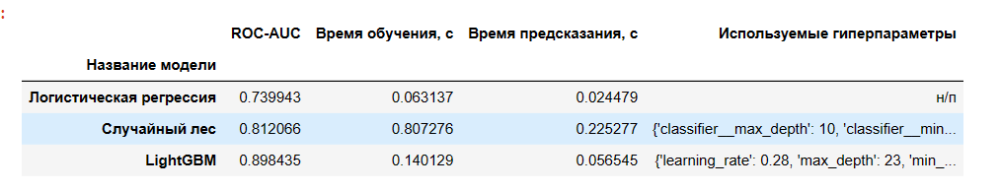

Наилучшие значения целевой метрики получены с помощью модели градиентного бустинга. 

***Проверка лучшей модели на тестовой выборке***

На данном шаге модель LightGBM была проверена на тестовой выборке и сделаны выводы по модели

**Признаки, использованные для обучения модели и их предобработка**

Для обучения модели были использованы следующие признаки (в порядке появления в финальном датафрейме до разделения):

1. Type - тип оплаты. Предобработка не требовалась. Один из наиболее важных признаков в финальной модели.

2. PaperlessBilling - является ли платежный документ электронным. Предобработка не требовалась.

3. PaymentMethod - способ оплаты. Предобработка не требовалась.

3. MonthlyCharges - размер ежемесячной платы. Предобработка не требовалась. Один из наиболее важных признаков в финальной модели.

4. gender - пол клиента. Предобработка не требовалась.

5. SeniorCitizen - является ли клиент пенсионером. Предобработка не требовалась.

6. Partner - наличие супруга(и). Предобработка не требовалась.

7. Dependents - наличие иждивенцев. Предобработка не требовалась.

8. Churn - ушел ли клиент. Целевой признак. Создан на основе признака EndDate.

9. ContractTerm - длительность действия договора в днях (до даты завершения договора в случае ушедших клиентов, либо до даты выгрузки данных (01.02.2020) в случае действующих клиентов. Создан как разность признаков EndDate (либо даты выгрузки) и BeginDate. Наиболее важный признак в финальной модели.

10. Phone - пользуется ли клиент услугами телефонии от компании. Создан на основе признака MultipleLines (пропуск соответствует значению 0, Yes либо No значению 1).

Таким образом в финальном датасете не использовались признаки из файла Internet ввиду их высокой мультиколлинеарности. При удалении данных признаков мы исходили из предположения, что набор услуг интернета заложен в размере ежемесячного платежа (признак MonthlyCharges).

**Итоговая модель**

В данном разделе описана финальная модель и ее показатели.

В качестве лучшей модели была выбрана модель градиентного бустинга LightGBM. Ниже перечислены ее гиперпараметры:

- learning_rate (скорость обучения) - 0.28

- max_depth (максимальная глубина деревьев в составе модели) - 23

- min_data_in_leaf (минимальное количество наблюдений в каждом узле дерева) - 1

- n_estimators (количество моделей деревьев) - 700

- num_leaves (максимальное количество листьев в составе дерева) - 3

- reg_alpha (L1 регуляризация) - 0.2

- reg_lambda (L2 регуляризация) - 0.5

- subsample_for_bin (количество наблюдений для разбивки признаков на "корзины") - 4000.

Значение метрики ROC-AUC на тестовой выборке составило 0.8984. Ниже приведен график ROC, а также нормализованная матрица ошибок:

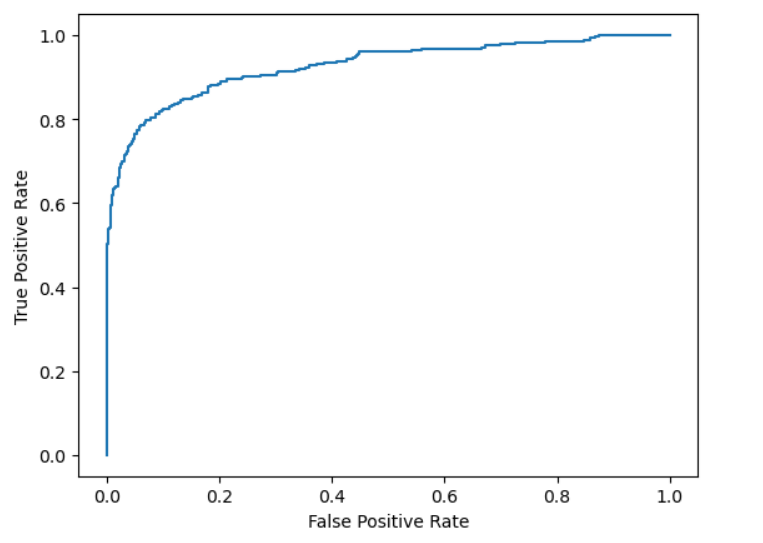

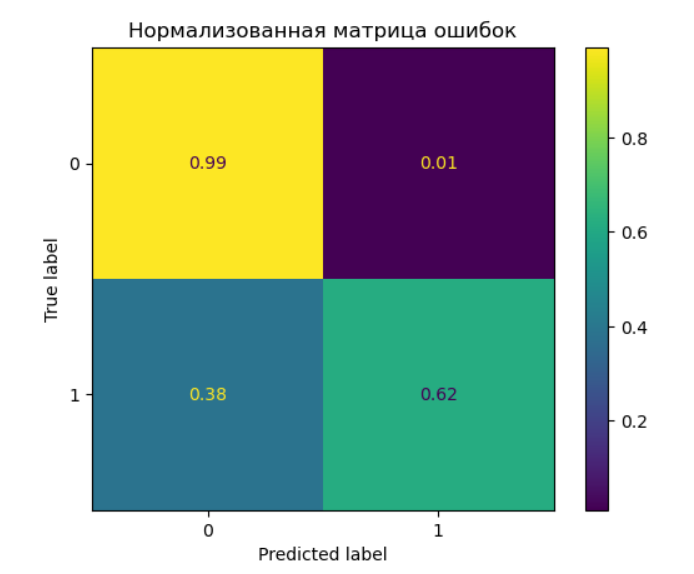

Из приведенных графиков видно, что значение TPR составляет 0.99 при TNR равном 0.62, то есть модель лучше предсказывает клиентов, которые ушли, чем тех, с которыми контракт еще действует. Так, 38% клиентов, которые не собираются уходить, моделью будут распознаваться как клиенты, с которыми рекомендуется провести работу по удержанию. Такие результаты модели можно объяснить тем, что в обучающей выборке гораздо лучше представлены уже ушедшие клиенты.

Также ниже приведена важность признаков модели:

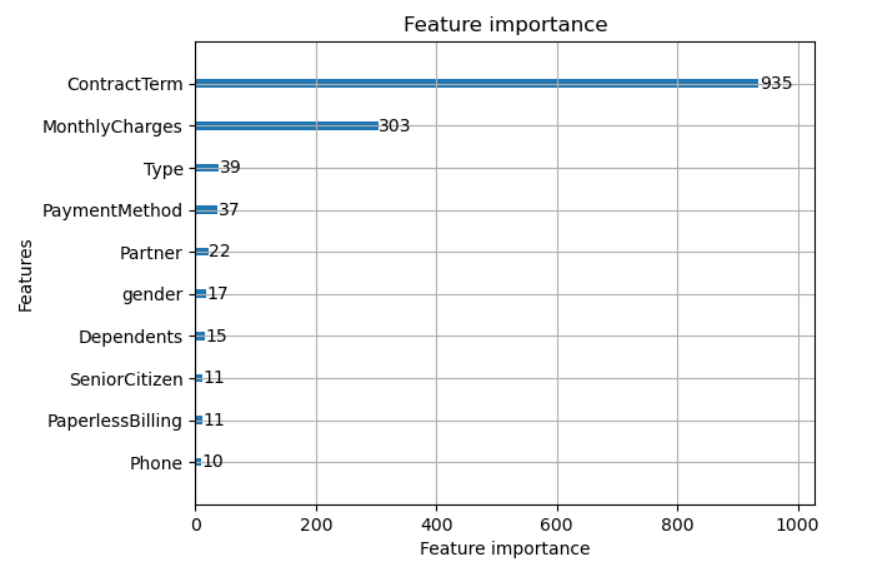

Наиболее важными параметрами модели являются срок действия контракта, размер ежемесячной платы и тип оплаты. Это подтверждается исследованием признаков в разрезе ушедших и действующих клиентов. Значения этих признаков демонстрируют наибольшие различия между двумя группами клиентов.

Таким образом, длительность контракта, стоимость ежемесячного платежа и способ оплаты являются ключевыми факторами, которые влияют на решение клиента остаться или уйти от компании.

**Вывод**

В приведенном отчете рассмотрены основные этапы проекта, выполнение изначального плана, описаны возникшие сложности. Также описаны признаки, отобранные для обучения моделей, и их предобработка, обозначены показатели наилучшей модели. Цель и задачи проекта выполнены.